In [1]:
import pandas as pd

In [2]:
from nltk import FreqDist

In [3]:
data = pd.read_csv('final_data.csv', index_col=[0] )

In [20]:
genre_list = list(data.columns[4:22])

In [22]:
genre_df =  {}

for i in genre_list:

    genre_df[i] = data[data[i] == 1]

In [34]:
p_techniques = list(data.columns[-6:])

In [41]:
counts_by_tech = {}

for i in p_techniques:
    
    counts_by_tech[i] = {}
    
    for x in genre_list:
        counts_by_tech[i][x] = FreqDist((" ".join(genre_df[x][i])).split())


In [49]:
import json

with open("word_counts_by_lemma.json", "w") as fp:
    json.dump(counts_by_tech, fp)

In [53]:
from sklearn.metrics import hamming_loss
from skmultilearn.problem_transform import ClassifierChain
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import CountVectorizer

In [51]:
intial_dct = {'process_type': [], 'ham_loss': [], 'stop_count': []}

def evaluator(dct, process_type, ham_loss, stop_count):
    pass


In [56]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

def cloud(words, genre, stops):
    
    plt.figure(figsize=(40,25))
    # clean
    subset = words
    cloud = WordCloud(
                            stopwords=stops,
                            background_color='black',
                            collocations=True,
                            width=2500,
                            height=1800
                            ).generate(" ".join(subset))
    plt.axis('off')
    plt.title(genre,fontsize=40)
    plt.imshow(cloud)

In [68]:
    
def getting_stops(process_type, num): 
    
    stops = []

    for i in genre_list:
        words = counts_by_tech[process_type][i].most_common(num)
        stops.extend([x[0] for x in words])

    stops = list(set(stops))

    return stops

In [88]:
stops = []
for i in genre_list:
    words = counts_by_tech['wnl_lem'][i].most_common(300)
    set_ = set(x[0] for x in words)
    stops.append(set_)


In [90]:
stopping = list(set.intersection(*stops))

In [91]:
len(stopping)

145

In [69]:
stops = getting_stops('wnl_lem', 200)

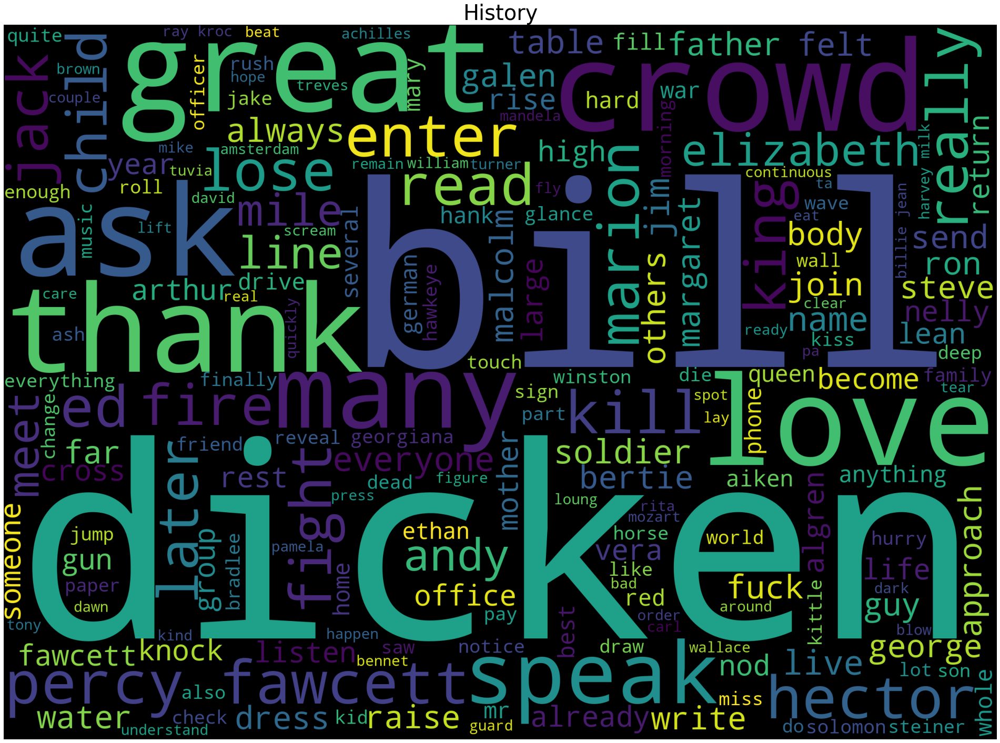

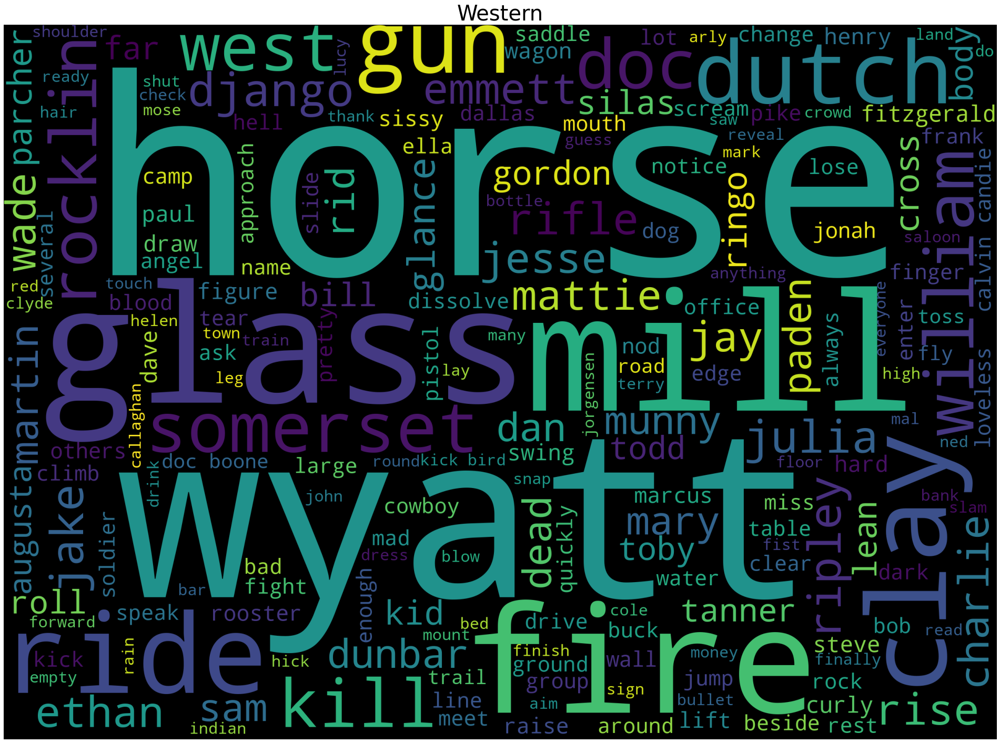

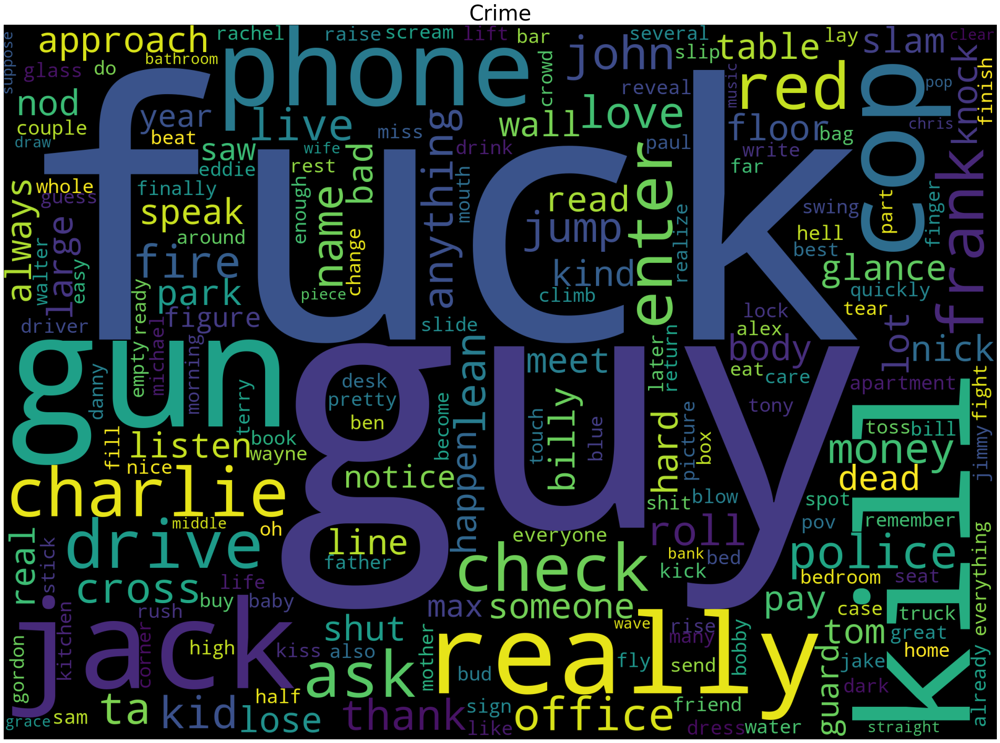

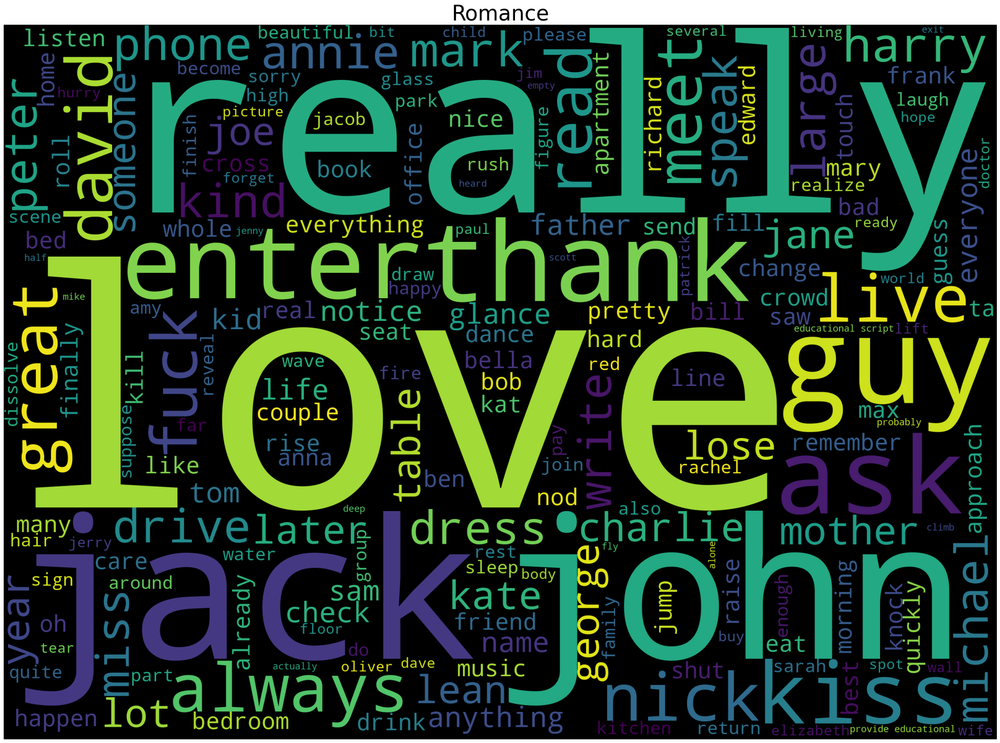

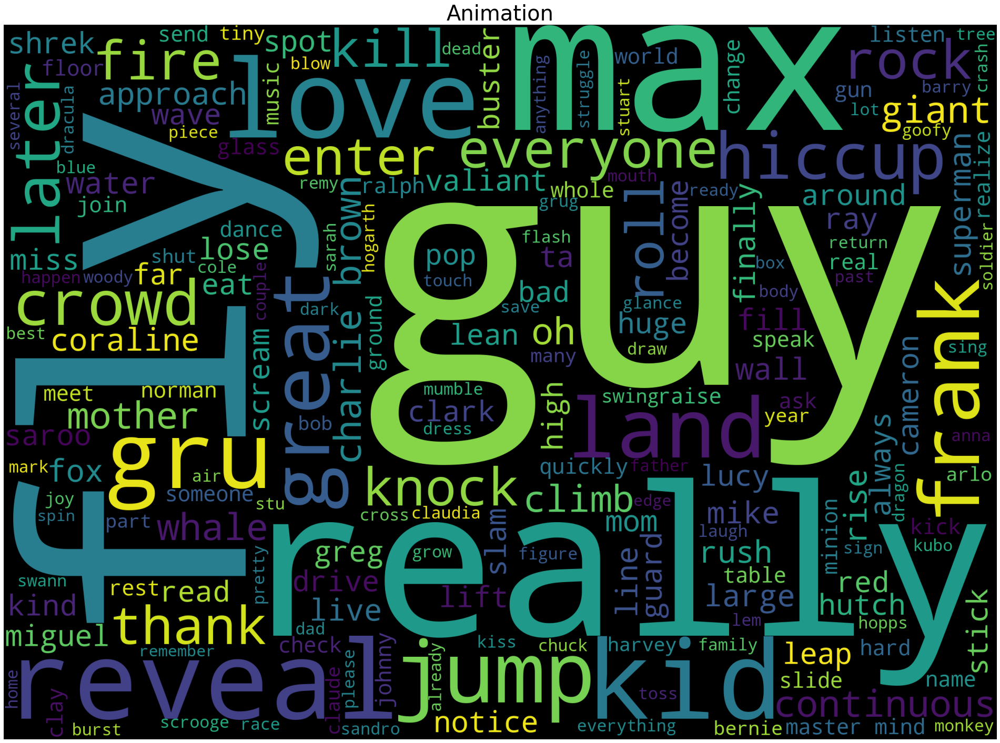

...

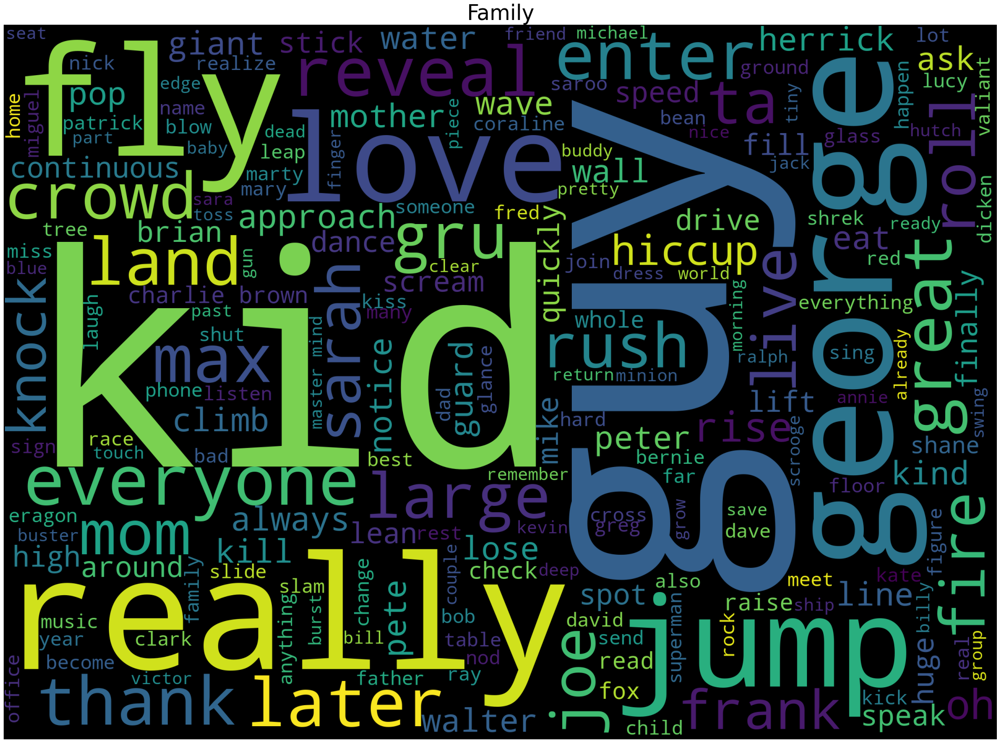

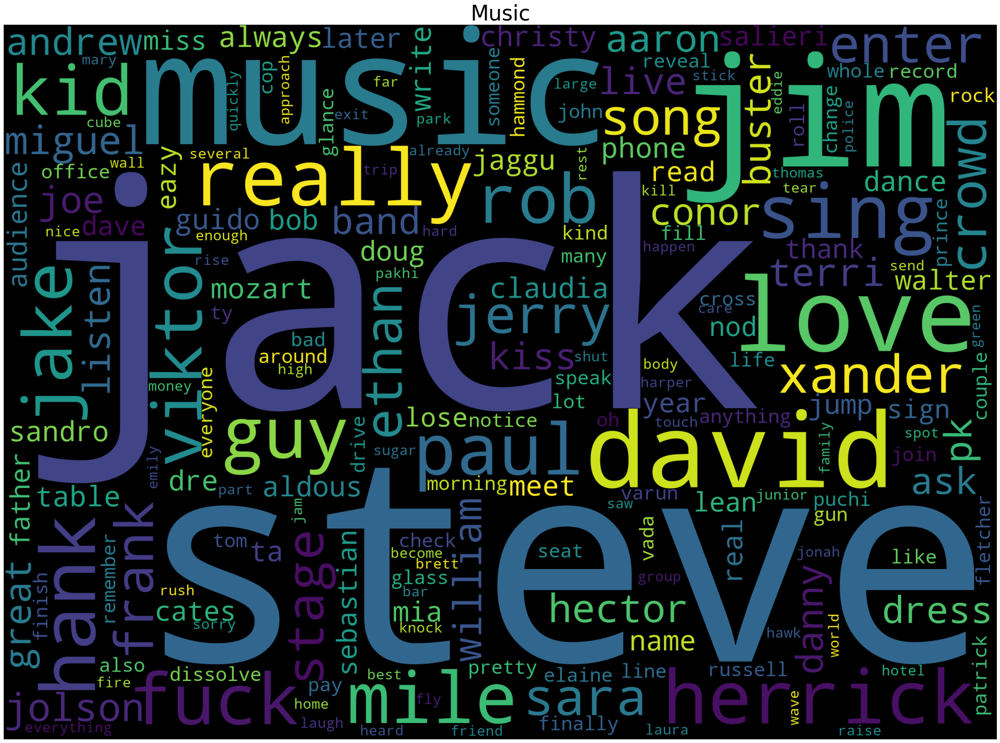

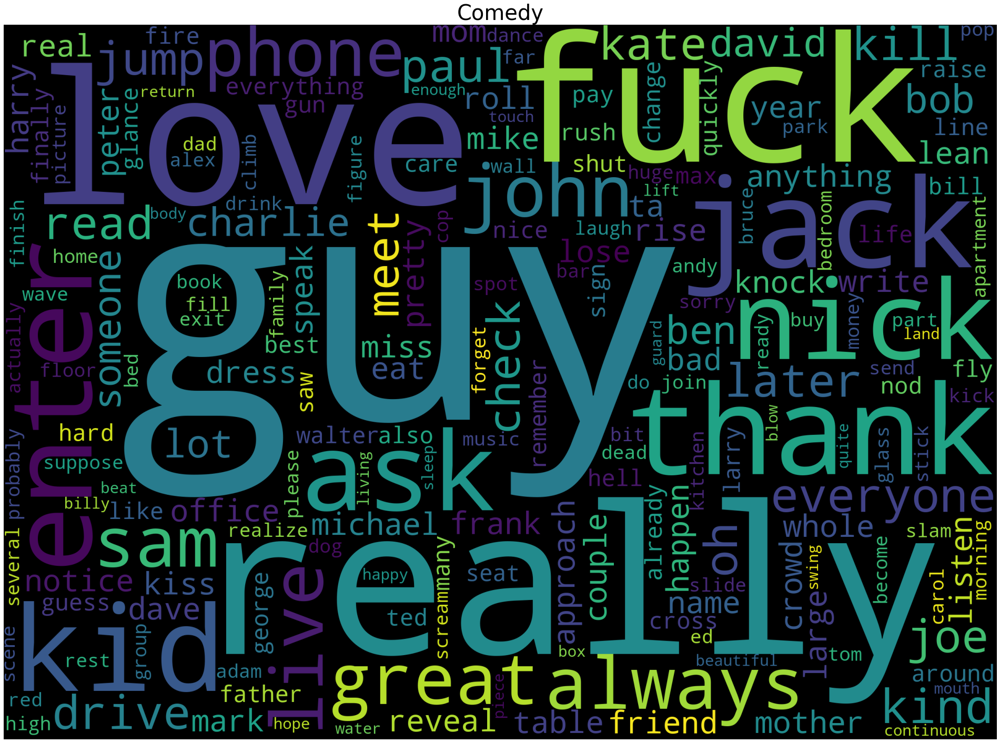

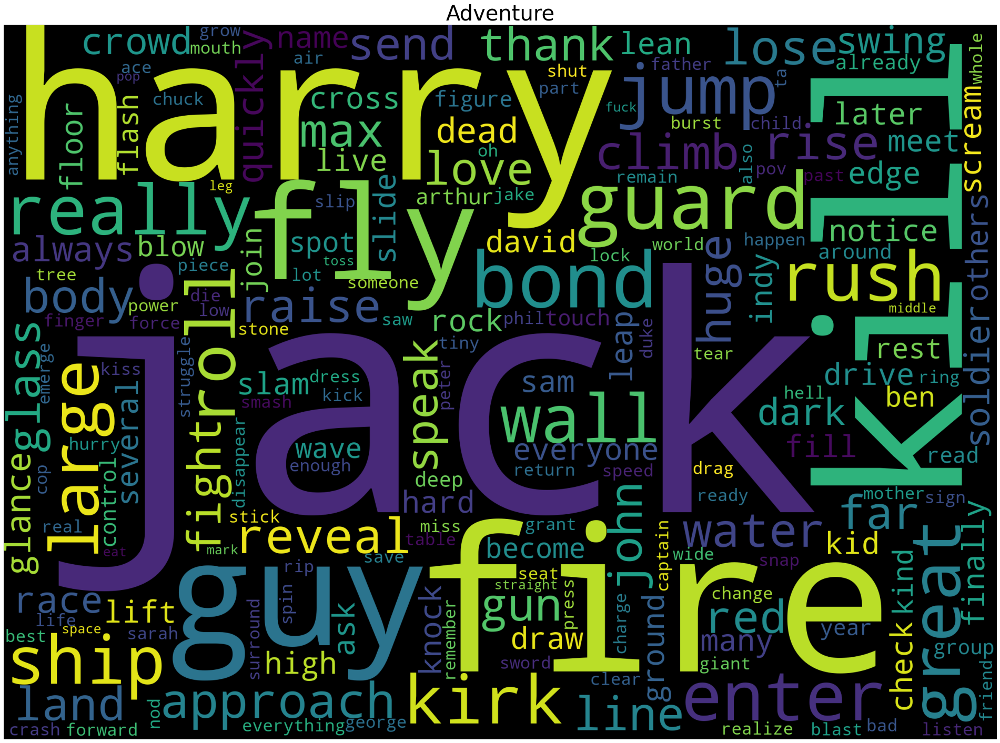

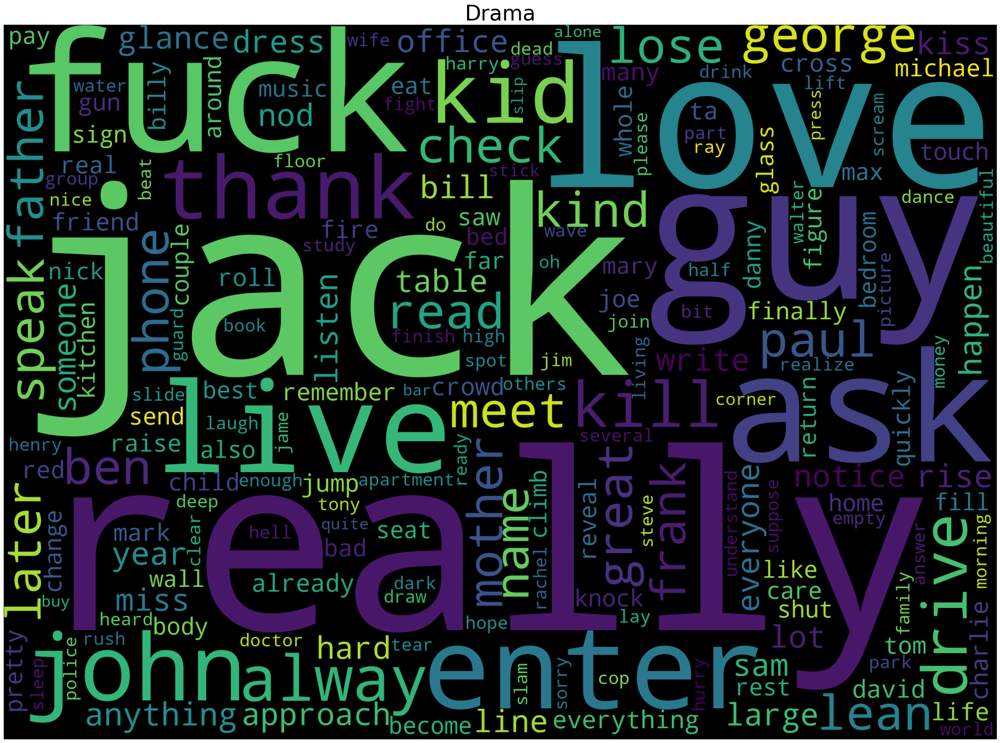

In [92]:
for i in genre_df.keys():
    
    cloud(genre_df[i].wnl_lem, i, stops=stopping)

In [99]:
with open('names.txt') as f:
    lines = f.readlines()

In [102]:
names = [x.strip('\n') for x in lines]

In [136]:
from itertools import chain

new_stops = list(chain(names, stopping))
new_stops.append('enter')

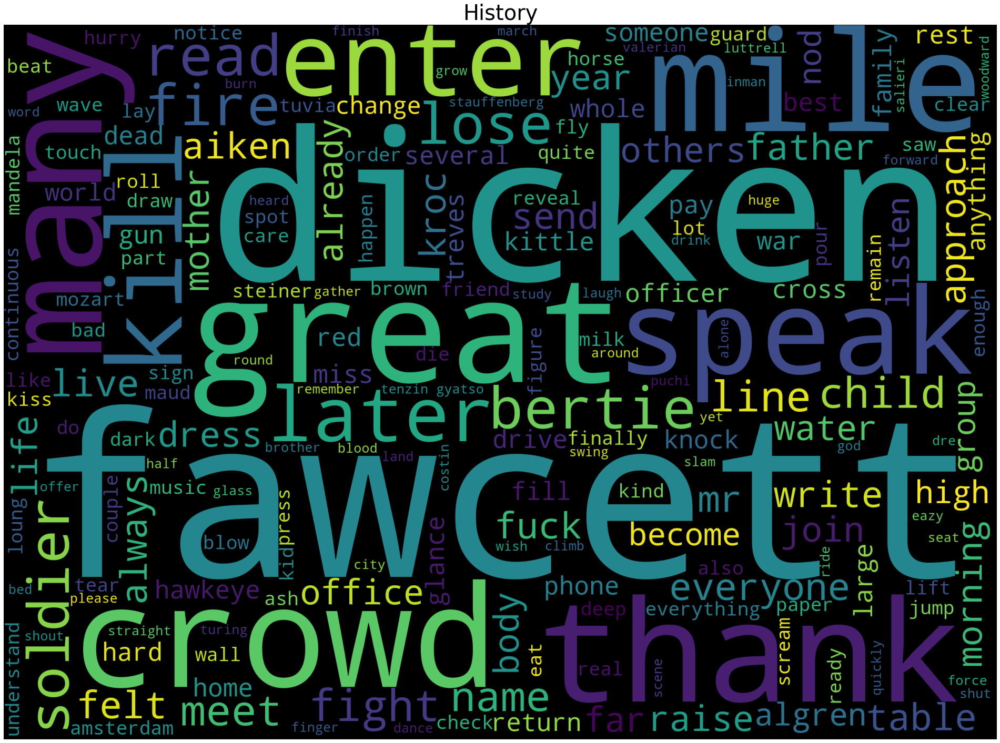

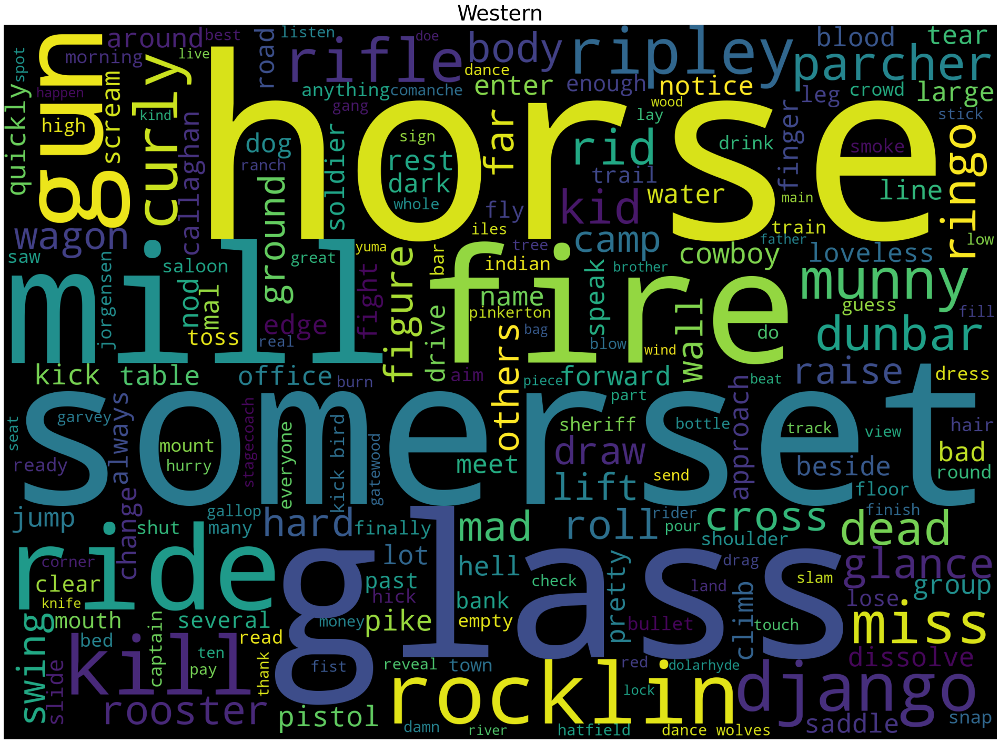

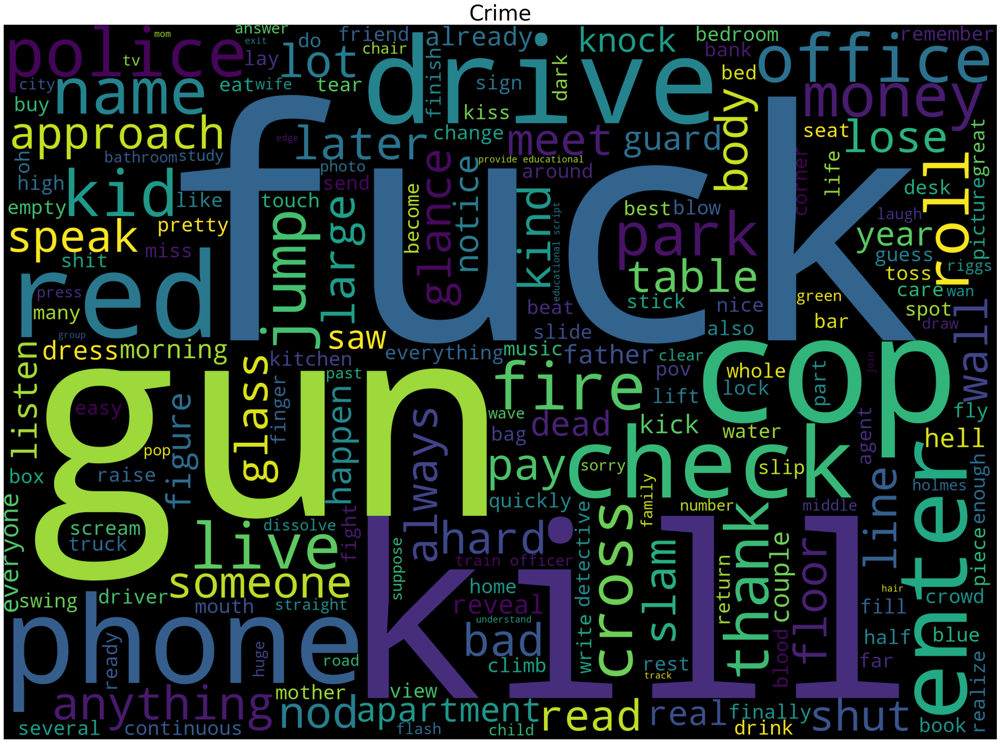

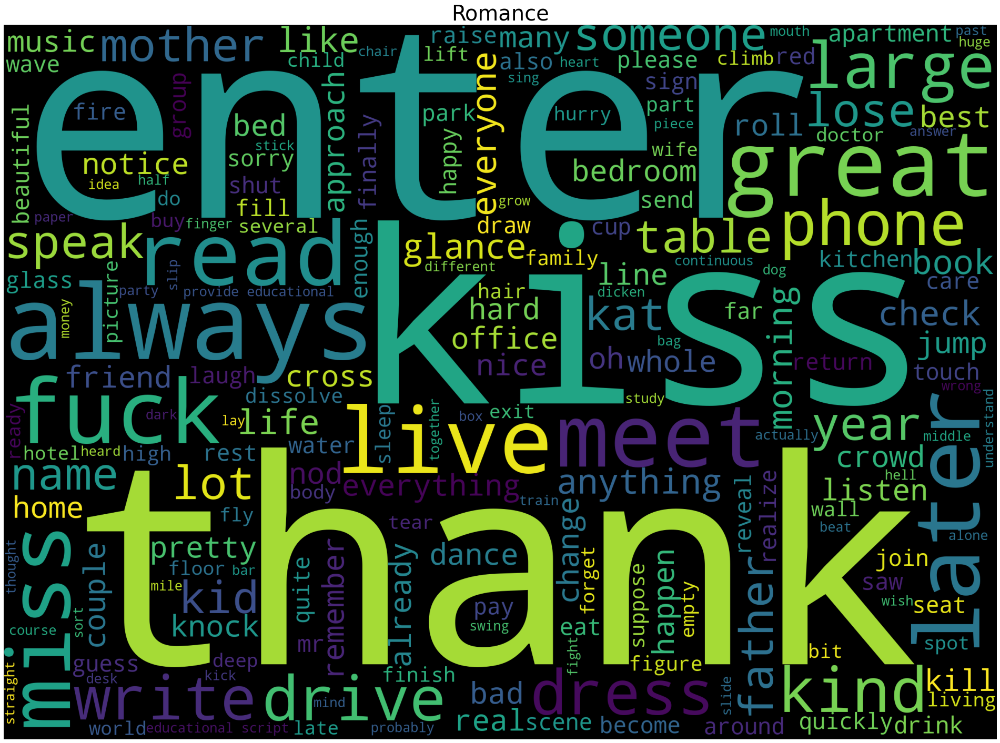

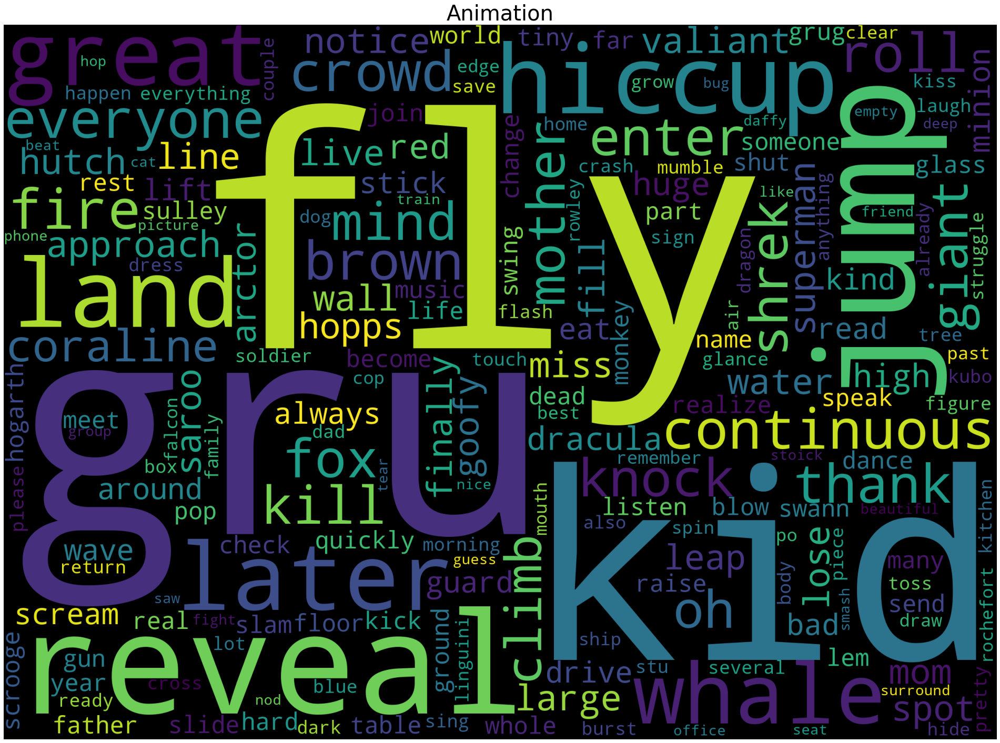

...

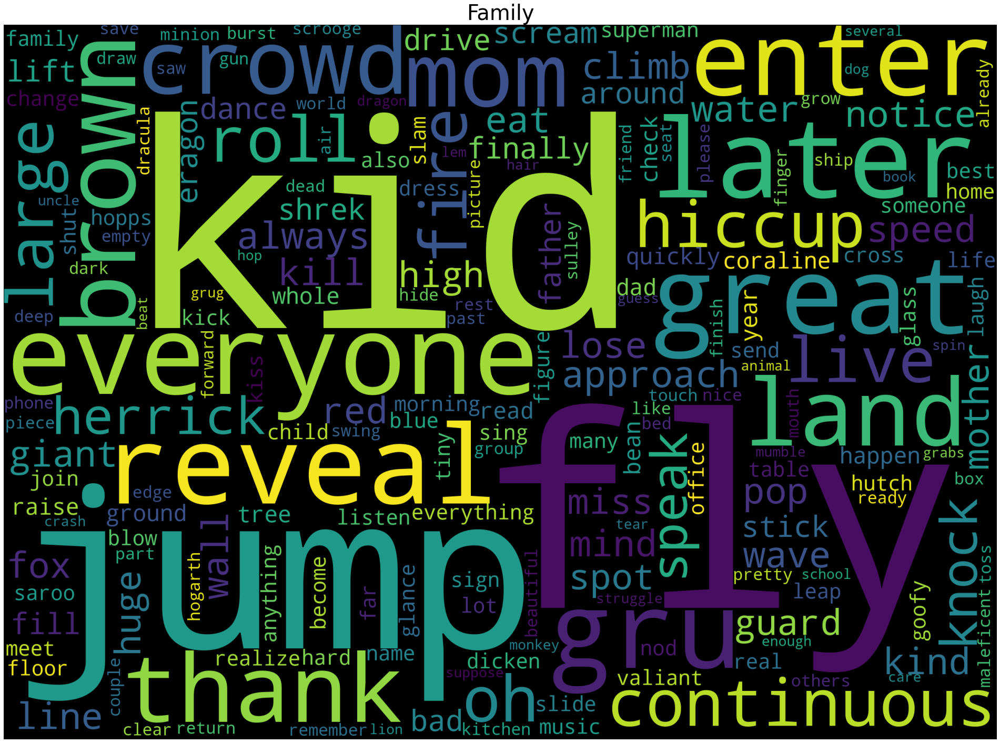

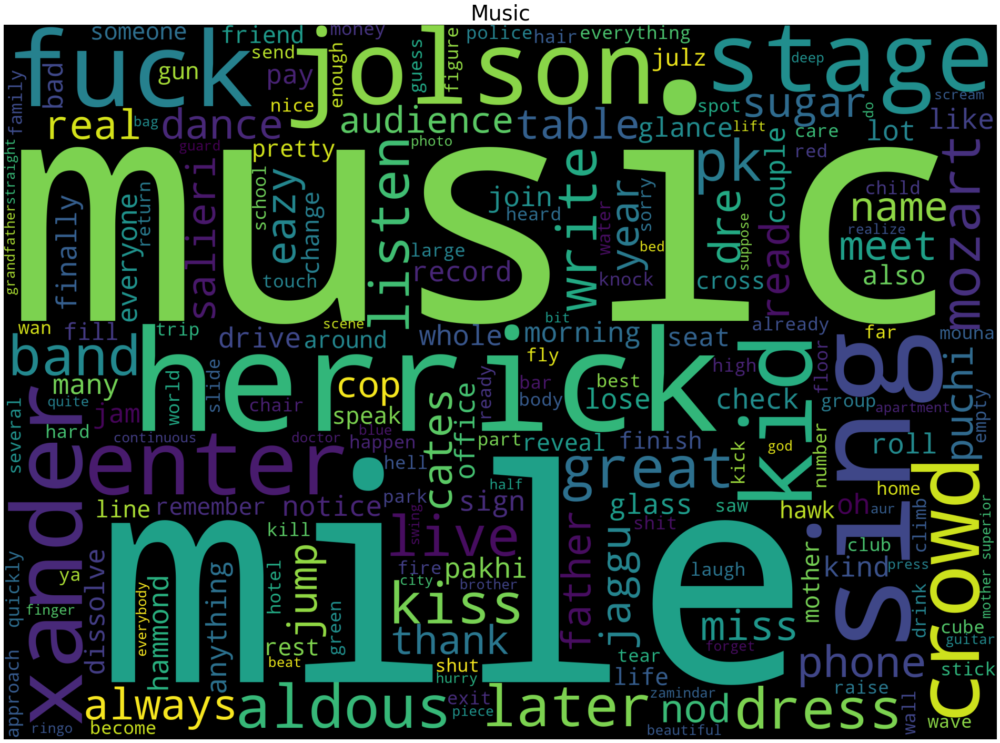

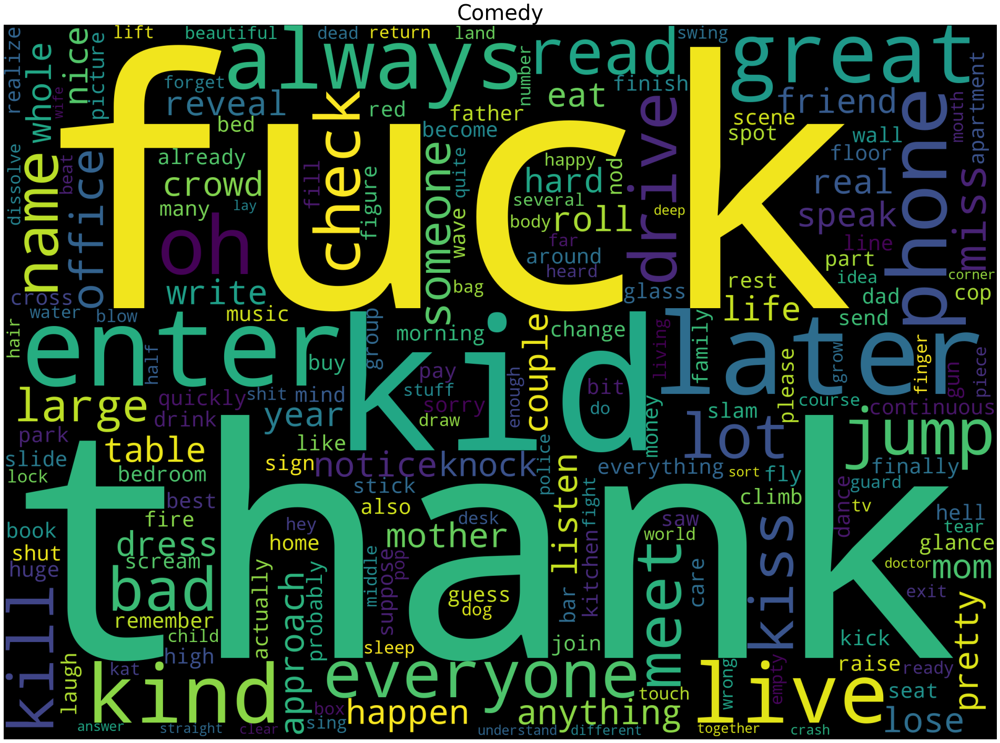

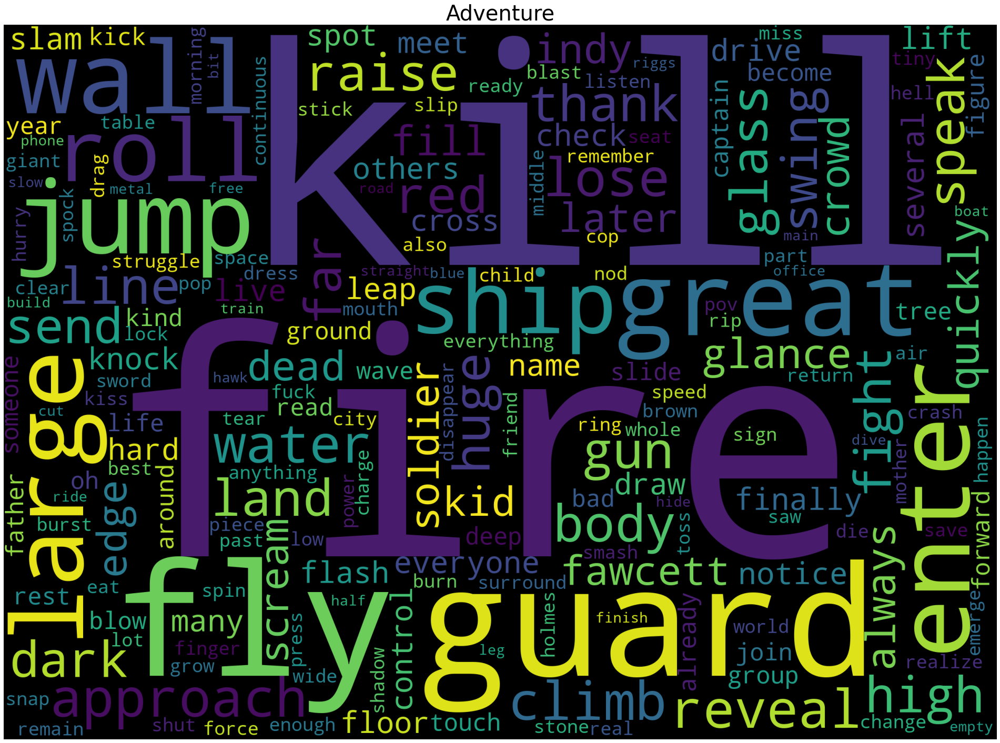

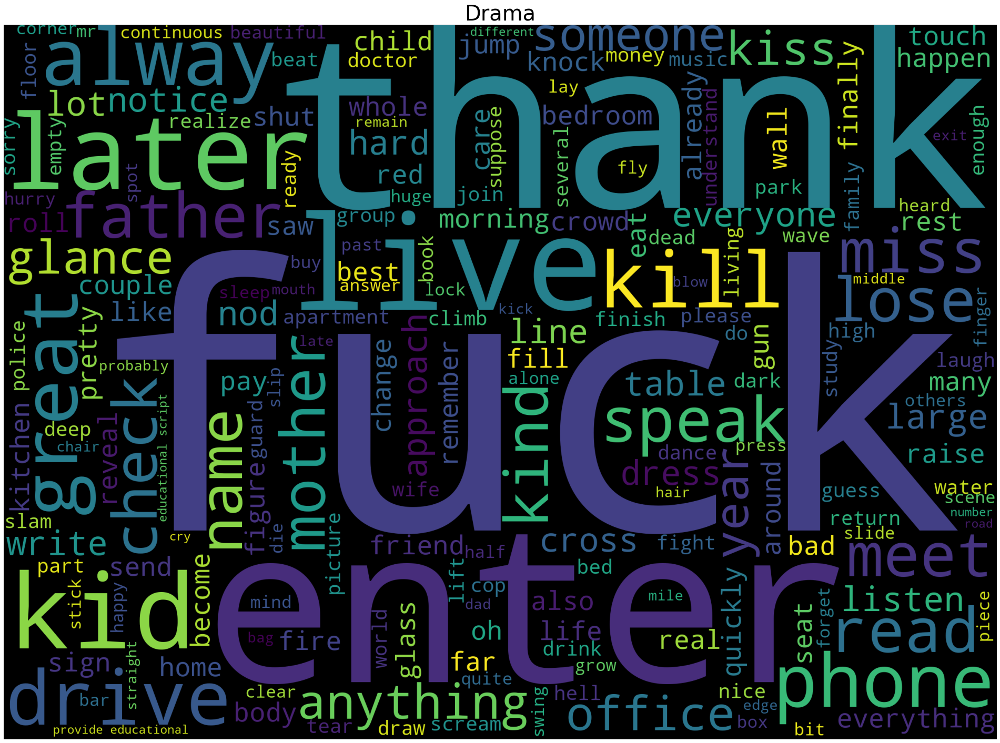

In [113]:
for i in genre_df.keys():
    
    cloud(genre_df[i].wnl_lem, i, stops=new_stops)

In [120]:
def update_lem(row, stops):

    new_row = row.split()
    updated_row = [x for x in new_row if x not in stops]
    row_row = " ".join(updated_row)

    return row_row

In [124]:
data['updated_lem'] = data.wnl_lem.apply(lambda x: update_lem(x, new_stops))

In [127]:
from sklearn.model_selection import train_test_split

In [126]:
data.to_csv('more_data.csv')

In [135]:
names = [x.lower() for x in names]

In [138]:
data['updated_lem'] = data.updated_lem.apply(lambda x: update_lem(x, names))

In [141]:
data.head()

X = data.loc[: , ['title', 'genre', 'updated_lem']].copy()
y = data.loc[: , genre_list]

In [144]:
X_train, X_test, y_train, y_test = train_test_split(X, y)

In [146]:
pipe = Pipeline([('cv', CountVectorizer()), ('model', ClassifierChain(LogisticRegression()))])
pipe.fit(X_train.updated_lem, y_train)

C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\mikey\anaconda3\envs\contest_env\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.

Pipeline(steps=[('cv', CountVectorizer()),
                ('model',
                 ClassifierChain(classifier=LogisticRegression(),
                                 require_dense=[True, True]))])

In [147]:
from sklearn.metrics import hamming_loss

data.to_csv('better_data.csv')

In [148]:
hamming_loss(y_test, pipe.predict(X_test.updated_lem))

0.11802721088435374

In [149]:
y_pred = pipe.predict(X_test.updated_lem)

In [166]:
y_pred.toarray()[1]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1], dtype=int64)

In [154]:
y_test.head()

,History,Western,Crime,Romance,Animation,Thriller,Documentary,War,Action,Horror,SciFi,Fantasy,Mystery,Family,Music,Comedy,Adventure,Drama
1224,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
551,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1
1836,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0
639,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0
996,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [155]:
X_test.title

1224              Run All Nigh
551                 Foxcatcher
1836                  Tron 2.0
639     Halloween Resurrection
996                    Momento
                 ...          
194                Bad Teacher
1262          Sex And The City
908                 Lost Souls
368                Constantine
1768        The Usual Suspects
Name: title, Length: 490, dtype: object

In [238]:
def labeller(arry):
    lst = []

    for i, x in enumerate(arry):
        if x ==1:
            lst.append(genre_list[i])

    return lst


In [214]:
labeller(y_pred.toarray()[300])

[0, 0, 0, 'Romance', 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 'Drama']

In [215]:
y_test.iloc[300]

History        0
Western        0
Crime          0
Romance        1
Animation      0
Thriller       0
Documentary    0
War            0
Action         0
Horror         0
SciFi          0
Fantasy        0
Mystery        0
Family         1
Music          1
Comedy         0
Adventure      0
Drama          1
Name: 1239, dtype: int64

In [216]:
X_test.iloc[300]

title                                        Save The Last Dance
genre                    ['Drama', 'Family', 'Romance', 'Music']
updated_lem    dance revision current revision rewrite revisi...
Name: 1239, dtype: object

In [222]:
import numpy as np

np.array(y_test.iloc[0])

array([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int64)

In [233]:
dct = {'title': [], 'real': [], 'pred': []}

for i in range(len(y_test)):

    dct['real'].append(np.array(y_test.iloc[i]))
    dct['pred'].append(y_pred.toarray()[i])
    dct['title'].append(X_test.title.iloc[i])

In [236]:
prediction_data = pd.DataFrame(dct)

In [242]:
prediction_data['predicted genre'] = prediction_data.pred.apply(lambda x: labeller(x))

In [241]:
prediction_data['actual genre'] = prediction_data.real.apply(lambda x: labeller(x))

In [243]:
prediction_data.head()

,title,real,pred,actual genre,predicted genre
0,Run All Nigh,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[Action],"[Thriller, Drama]"
1,Foxcatcher,"[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, ...","[Thriller, Drama]","[Mystery, Drama]"
2,Tron 2.0,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, ...","[Action, SciFi, Adventure]","[Action, SciFi, Adventure]"
3,Halloween Resurrection,"[0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...","[Thriller, Horror]","[Thriller, Horror]"
4,Momento,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[Drama],"[Crime, Thriller]"


In [249]:
ham_loss = []
for i in range(len(prediction_data)):
    ham_loss.append(hamming_loss(prediction_data.real[i], prediction_data.pred[i]))

In [251]:
prediction_data['ham_loss'] = ham_loss

In [260]:
prediction_data[prediction_data.ham_loss < 0.12].title

1                      Foxcatcher
2                        Tron 2.0
3          Halloween Resurrection
5                  A White Season
6      The Place Beyond The Pines
                  ...            
483          Bodies Rest & Motion
485                   Bad Teacher
486              Sex And The City
488                   Constantine
489            The Usual Suspects
Name: title, Length: 314, dtype: object

In [274]:
import tmdbsimple as tmdb

tmdb.API_KEY = '68823d90fee6a8400966948215436693'
search = tmdb.Search()

In [278]:
popularity = []
vote_average = []
vote_count = []

for i in prediction_data.title:
    popularity.append(search.movie(query= i)['results'][0]['popularity'])
    vote_average.append(search.movie(query= i)['results'][0]['vote_average'])
    vote_count.append(search.movie(query= i)['results'][0]['vote_count'])


In [282]:
prediction_data['popularity'] = popularity
prediction_data['vote_average'] = vote_average
prediction_data['vote_count'] = vote_count

<AxesSubplot:ylabel='Frequency'>

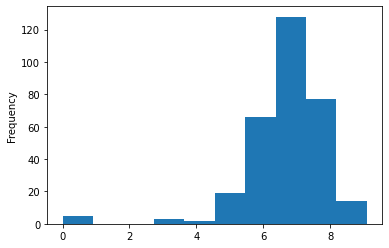

In [290]:
prediction_data[prediction_data.ham_loss < prediction_data.ham_loss.mean()].vote_average.plot(kind='hist')

In [306]:
df_high = prediction_data[prediction_data.ham_loss > prediction_data.ham_loss.mean()].copy()

In [307]:
df_low = prediction_data[prediction_data.ham_loss < prediction_data.ham_loss.mean()].copy()

In [308]:
def genre_label(row, genre):

    for x in row:
        if x == genre:
            return 1
        else:
            return 0

In [317]:
for i in genre_list:
    df_high[i] = df_high['predicted genre'].apply(lambda x: genre_label(x, i))
    df_low[i] = df_low['predicted genre'].apply(lambda x: genre_label(x, i))


In [329]:
high_counts = []
low_counts = []

for i in genre_list:

    high_counts.append(df_high[i].sum()/len(df_high))
    low_counts.append(df_low[i].sum()/len(df_low))

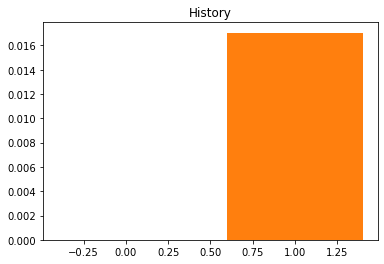

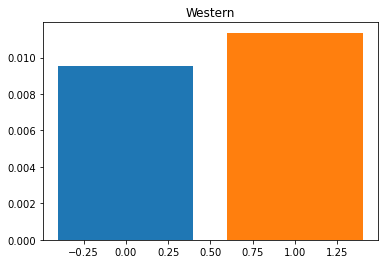

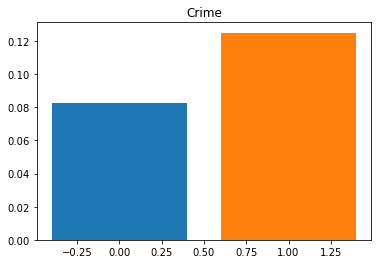

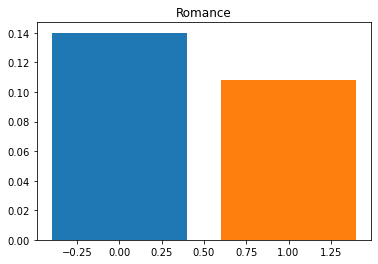

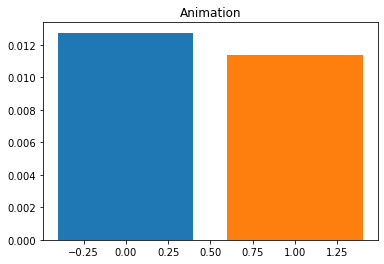

...

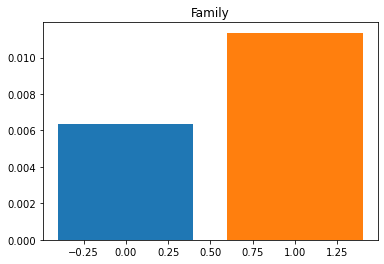

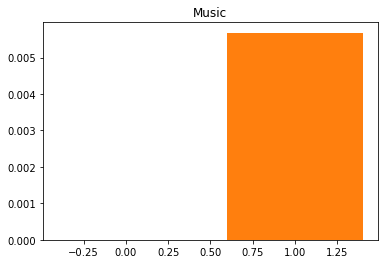

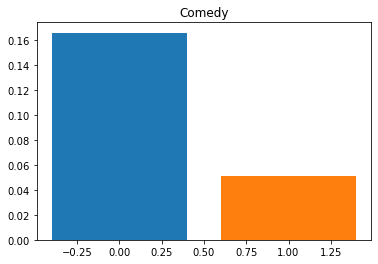

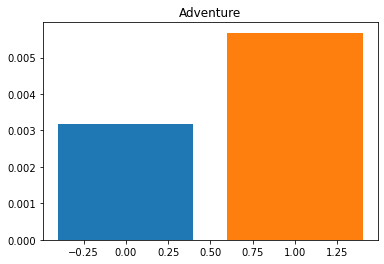

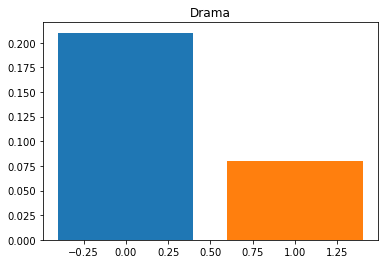

<Figure size 432x288 with 0 Axes>

In [336]:
import matplotlib.pyplot as plt

for i, x in enumerate(genre_list):

    plt.bar(0, low_counts[i])
    plt.bar(1, high_counts[i])
    plt.title(x)
    

    plt.show()
    plt.clf()

In [337]:
prediction_data

,title,real,pred,actual genre,predicted genre,ham_loss,popularity,vote_average,vote_count
0,Run All Nigh,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[Action],"[Thriller, Drama]",0.166667,29.414,6.4,2416
1,Foxcatcher,"[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, ...","[Thriller, Drama]","[Mystery, Drama]",0.111111,8.872,6.7,1956
2,Tron 2.0,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, ...","[Action, SciFi, Adventure]","[Action, SciFi, Adventure]",0.000000,81.006,6.4,6028
3,Halloween Resurrection,"[0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...","[Thriller, Horror]","[Thriller, Horror]",0.000000,24.591,4.6,948
4,Momento,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[Drama],"[Crime, Thriller]",0.166667,2.165,6.0,4
...,...,...,...,...,...,...,...,...,...
485,Bad Teacher,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[Comedy],[Comedy],0.000000,23.477,5.6,4048
486,Sex And The City,"[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[Romance, Comedy, Drama]","[Romance, Comedy, Drama]",0.000000,97.027,6.6,1804
487,Lost Souls,"[0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, ...","[Thriller, Horror]","[Thriller, Mystery, Drama]",0.166667,8.045,5.1,134
488,Constantine,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, ...","[Action, Horror, Fantasy]","[Action, Horror]",0.055556,72.673,7.0,5611


In [338]:
data.head()

,title,text,genre,genre_amount,History,Western,Crime,Romance,Animation,Thriller,...,Comedy,Adventure,Drama,wnl_lem,wb_lem,pt_lem,ss_stem,ps_stem,ls_stem,updated_lem
0,Domino,b'D O M I N O\r\n...,"['Thriller', 'Action', 'Crime']",3,0,0,1,0,0,1,...,0,0,0,richard kelly september original text script n...,by richard kelly september the original text o...,richard kelly september original text script n...,richard kelli septemb origin text script numbe...,richard kelli septemb origin text script numbe...,richard kel septemb origin text script numb sc...,original text script number scene scene retain...
1,Knocked Up,b'KNOCKED UP\r\n\r\nWritten by\r\n\r\nJudd Apa...,"['Comedy', 'Romance', 'Drama']",3,0,0,0,1,0,0,...,1,0,1,write judd apatow house day cute chunky jewish...,up write by judd apatow house day ben cute in ...,write judd apatow house day ben cute chunky je...,written judd apatow hous day ben cute chunki j...,written judd apatow hous day ben cute chunki j...,writ jud apatow hous day ben cut chunky jew gu...,write apatow cute chunky jewish sort box fight...
2,10 Things I Hate About You,b'TEN THINGS I HATE ABOUT YOU\r\n\r\nwritten b...,"['Comedy', 'Romance', 'Drama']",3,0,0,0,1,0,0,...,1,0,1,thing hate write karen mccullah lutz kirsten s...,thing hate about you write by karen mccullah l...,thing hate write karen mccullah lutz kirsten s...,thing hate written karen mccullah lutz kirsten...,thing hate written karen mccullah lutz kirsten...,thing hat writ kar mccullah lutz kirst smi bas...,hate write mccullah lutz base shakespeare revi...
3,10000 B C,"b""10,000 B.C.\r\nby\r\nRoland Emmerich & Haral...","['Adventure', 'Action', 'Drama', 'Fantasy']",4,0,0,0,0,0,0,...,0,1,1,roland emmerich harald kloser roland emmerich ...,by roland emmerich harald kloser roland emmeri...,roland emmerich harald kloser roland emmerich ...,roland emmerich harald kloser roland emmerich ...,roland emmerich harald kloser roland emmerich ...,roland emmerich harald klos roland emmerich re...,emmerich harald kloser emmerich revision haral...
4,12 And Holding,b'12 AND HOLDING\r\n\r\nWritten by\r\n\r\nAnth...,['Drama'],1,0,0,0,0,0,0,...,0,0,1,hold write anthony cipriano neighborhood stree...,and hold write by anthony cipriano fade neighb...,hold write anthony cipriano neighborhood stree...,hold written anthoni cipriano neighborhood str...,hold written anthoni cipriano neighborhood str...,hold writ anthony cipriano neighb street morn ...,write neighborhood morning twin carges ride bi...


In [341]:
data.to_csv('topic_data.csv')